In [ ]:
import argparse
import sys
from os import listdir
from os.path import isfile, join
from typing import Dict, List, Tuple
!pip install imagehash
import imagehash
import numpy as np
from PIL import Image


def calculate_signature(image_file: str, hash_size: int) -> np.ndarray:
    """ 
    Calculate the dhash signature of a given file
    
    Args:
        image_file: the image (path as string) to calculate the signature for
        hash_size: hash size to use, signatures will be of length hash_size^2
    
    Returns:
        Image signature as Numpy n-dimensional array or None if the file is not a PIL recognized image
    """
    pil_image = Image.open(image_file).convert("L").resize(
                        (hash_size+1, hash_size),
                        Image.ANTIALIAS)
    dhash = imagehash.dhash(pil_image, hash_size)
    signature = dhash.hash.flatten()
    pil_image.close()
    return signature

        
def find_near_duplicates(input_dir: str, threshold: float, hash_size: int, bands: int) -> List[Tuple[str, str, float]]:
    """
    Find near-duplicate images
    
    Args:
        input_dir: Directory with images to check
        threshold: Images with a similarity ratio >= threshold will be considered near-duplicates
        hash_size: Hash size to use, signatures will be of length hash_size^2
        bands: The number of bands to use in the locality sensitve hashing process
        
    Returns:
        A list of near-duplicates found. Near duplicates are encoded as a triple: (filename_A, filename_B, similarity)
    """
    rows: int = int(hash_size**2/bands)
    signatures = dict()
    hash_buckets_list: List[Dict[str, List[str]]] = [dict() for _ in range(bands)]
    
    # Build a list of candidate files in given input_dir
    file_list = [join(input_dir, f) for f in listdir(input_dir) if isfile(join(input_dir, f))]

    # Iterate through all files in input directory
    for fh in file_list:
        try:
            signature = calculate_signature(fh, hash_size)
        except IOError:
            # Not a PIL image, skip this file
            continue

        # Keep track of each image's signature
        signatures[fh] = np.packbits(signature)
        
        # Locality Sensitive Hashing
        for i in range(bands):
            signature_band = signature[i*rows:(i+1)*rows]
            signature_band_bytes = signature_band.tobytes()
            if signature_band_bytes not in hash_buckets_list[i]:
                hash_buckets_list[i][signature_band_bytes] = list()
            hash_buckets_list[i][signature_band_bytes].append(fh)

    # Build candidate pairs based on bucket membership
    candidate_pairs = set()
    for hash_buckets in hash_buckets_list:
        for hash_bucket in hash_buckets.values():
            if len(hash_bucket) > 1:
                hash_bucket = sorted(hash_bucket)
                for i in range(len(hash_bucket)):
                    for j in range(i+1, len(hash_bucket)):
                        candidate_pairs.add(
                            tuple([hash_bucket[i],hash_bucket[j]])
                        )

    # Check candidate pairs for similarity
    near_duplicates = list()
    for cpa, cpb in candidate_pairs:
        hd = sum(np.bitwise_xor(
                np.unpackbits(signatures[cpa]), 
                np.unpackbits(signatures[cpb])
        ))
        similarity = (hash_size**2 - hd) / hash_size**2
        if similarity > threshold:
            near_duplicates.append((cpa, cpb, similarity))
            
    # Sort near-duplicates by descending similarity and return
    near_duplicates.sort(key=lambda x:x[2], reverse=True)
    return near_duplicates


     |████████████████████████████████| 812 kB 5.2 MB/s 
  Created wheel for imagehash: filename=ImageHash-4.2.1-py2.py3-none-any.whl size=295206 sha256=0630a445410f74aec79cb77db0bd5d233a015eceda4a2666eb4d19c112cc089f
  Stored in directory: /root/.cache/pip/wheels/4c/d5/59/5e3e297533ddb09407769762985d134135064c6831e29a914e
Successfully built imagehash


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
input_dir='/content/drive/My Drive/input'

In [ ]:
def showimages(img1,img2):
  fig = plt.figure(figsize=(10, 7))
  rows = 1
  columns = 2
  fig.add_subplot(rows, columns, 1)
  image1 = plt.imread(img1)
  plt.imshow(image1)
  plt.axis('off')
  plt.title("First Image")

  fig.add_subplot(rows, columns, 2)

  image2 = plt.imread(img2)
  plt.imshow(image2)
  plt.axis('off')
  plt.title("Second Image")


In [ ]:
import cv2
from matplotlib import pyplot as plt

Found 119 near-duplicate images in /content/drive/My Drive/input (threshold 20.00%)
100.00% similarity: file 1: /content/drive/My Drive/input/boston_4850870_1.jpg - file 2: /content/drive/My Drive/input/boston_4850870_3.jpg
100.00% similarity: file 1: /content/drive/My Drive/input/boston_13693491_2 .jpg - file 2: /content/drive/My Drive/input/boston_1369349_2.jpg
100.00% similarity: file 1: /content/drive/My Drive/input/boston_121799941_2.jpg - file 2: /content/drive/My Drive/input/boston_12179994_1 (1).jpg
100.00% similarity: file 1: /content/drive/My Drive/input/boston_13693491_1.jpg - file 2: /content/drive/My Drive/input/boston_1369349_3.jpg
100.00% similarity: file 1: /content/drive/My Drive/input/boston_57246311_2.jpg - file 2: /content/drive/My Drive/input/boston_5724631_1.jpg
99.61% similarity: file 1: /content/drive/My Drive/input/girl_lights.jpg - file 2: /content/drive/My Drive/input/girl_lights_shrunk_to_1334x889.jpg
96.88% similarity: file 1: /content/drive/My Drive/input/

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


60.94% similarity: file 1: /content/drive/My Drive/input/boston_13997739_2.jpg - file 2: /content/drive/My Drive/input/seattle_1909058_2.jpg
60.55% similarity: file 1: /content/drive/My Drive/input/boston_18290558_2 (1) (1).jpg - file 2: /content/drive/My Drive/input/boston_86860771_1.jpg
60.16% similarity: file 1: /content/drive/My Drive/input/boston_5661892_2 (1).jpg - file 2: /content/drive/My Drive/input/boston_901090_1.jpg
60.16% similarity: file 1: /content/drive/My Drive/input/boston_4090224_2 (1).jpg - file 2: /content/drive/My Drive/input/boston_4349688_1.jpg
59.77% similarity: file 1: /content/drive/My Drive/input/seattle_5680462_2.jpg - file 2: /content/drive/My Drive/input/seattle_5680462_3.jpg
59.77% similarity: file 1: /content/drive/My Drive/input/boston_2763860_3.jpg - file 2: /content/drive/My Drive/input/seattle_3308979_1.jpg
59.77% similarity: file 1: /content/drive/My Drive/input/boston_25491897_1 (1).jpg - file 2: /content/drive/My Drive/input/boston_9094619_1 (1).

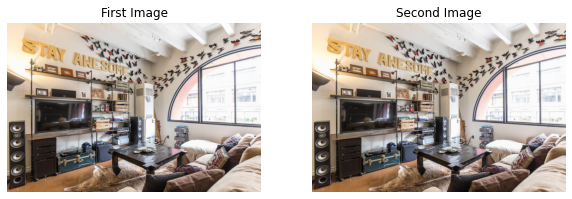

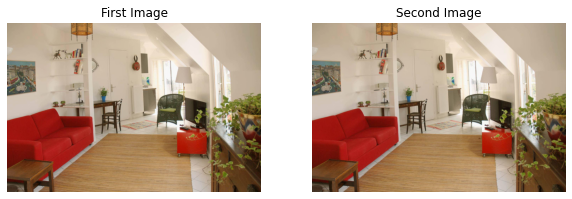

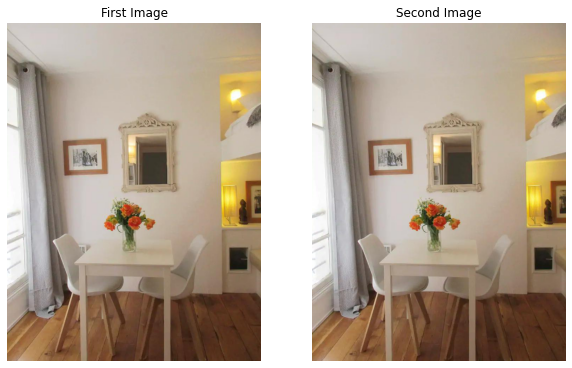

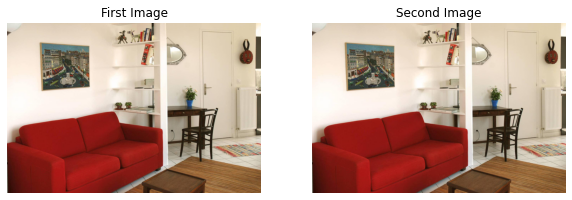

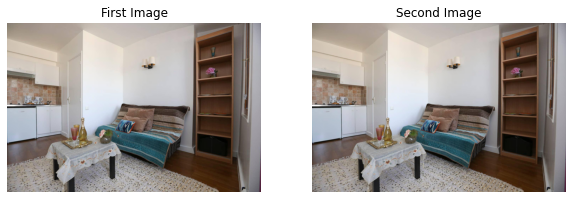

...

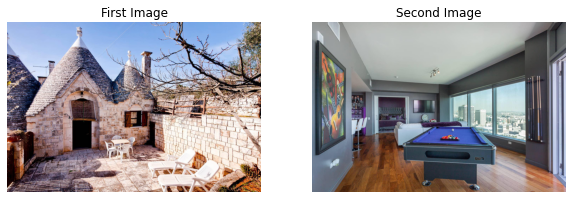

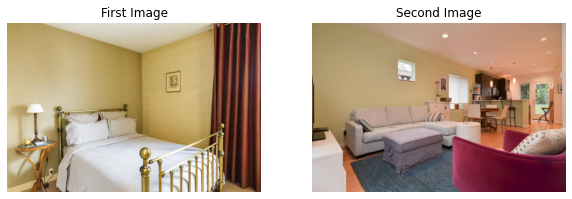

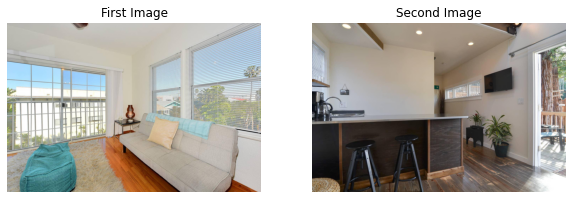

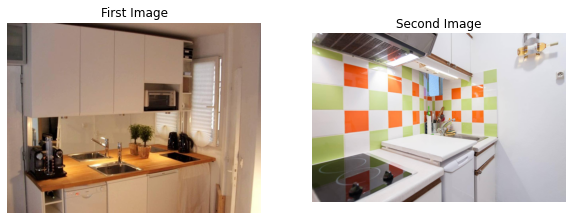

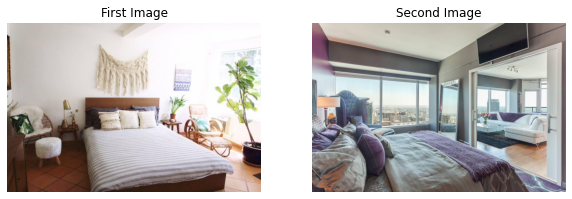

In [ ]:
from PIL import Image


threshold=0.2
hash_size=16
bands=16

near_duplicates = find_near_duplicates(input_dir, threshold, hash_size, bands)
if near_duplicates:
            print(f"Found {len(near_duplicates)} near-duplicate images in {input_dir} (threshold {threshold:.2%})")
            for a,b,s in near_duplicates:
                print(f"{s:.2%} similarity: file 1: {a} - file 2: {b}")

                showimages(a,b)
                # img1=a.rsplit('/', 1)[-1]
                # img2=b.rsplit('/', 1)[-1]
              
                # image = Image.open(a)
                # image.show()
                # image = plt.imread(a)
                # plt.imshow(image)
                # plt.show()
                
else:
            print(f"No near-duplicates found in {input_dir} (threshold {threshold:.2%})")